In [1]:
%matplotlib inline

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pylab
import os

pylab.rcParams['figure.figsize'] = (10.0, 8.0)

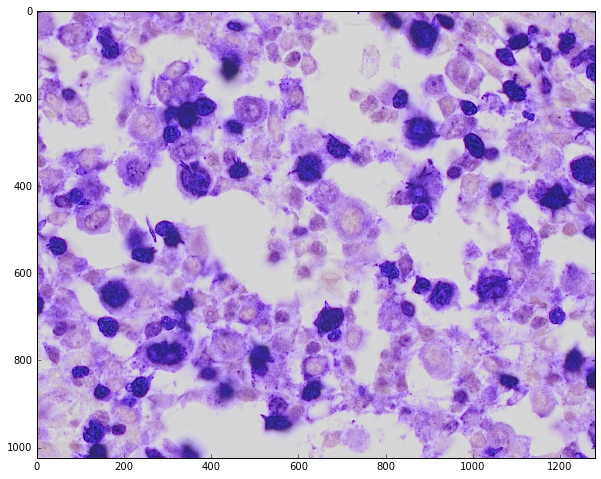

In [3]:
img = cv2.imread("Images/mp-16-2852_MCT_AgNOR_1152.tif")
binary_img = cv2.imread('Images/mp-16-2852_MCT_AgNOR_1152.tif', 0)
plt.imshow(img)
plt.show()

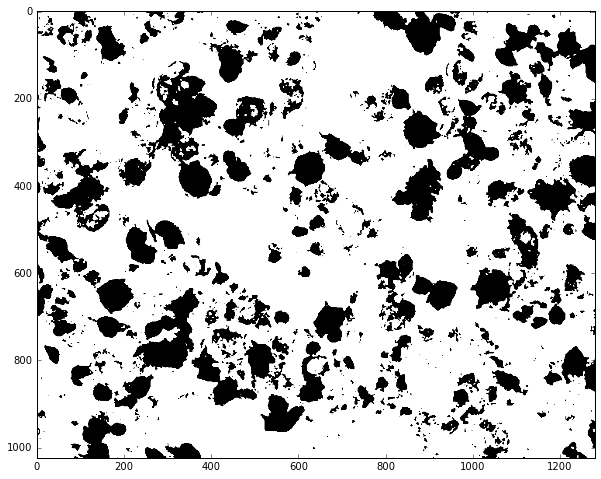

In [4]:
# ---------------------- TESTING OTSU ----------------------
blur = cv2.GaussianBlur(binary_img,(5,5),0)
ret3,th3 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
plt.imshow(th3, 'gray')
plt.show()

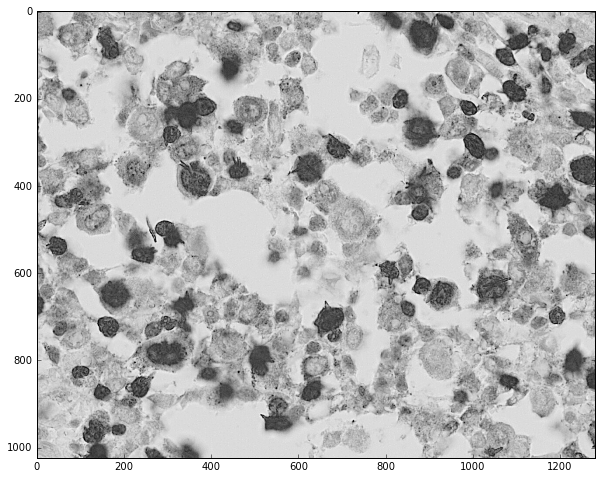

In [5]:
image = cv2.GaussianBlur(binary_img, (0,0), 3)
frame = cv2.addWeighted(binary_img, 1.5, image, -0.5, 0)
plt.imshow(frame, 'gray')
plt.show()

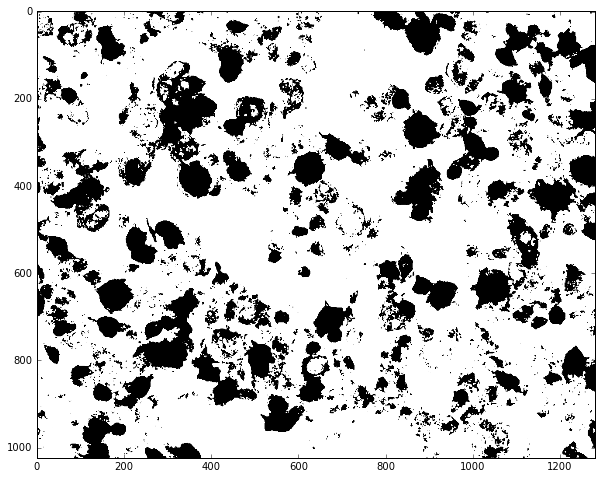

In [6]:
ret2,th2 = cv2.threshold(binary_img,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
plt.imshow(th2, 'gray')
plt.show()

In [7]:
contours, heirarchy = cv2.findContours(th2, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
cells = []
for cnt in contours:
    area = cv2.contourArea(cnt)
    if area >= 1000:
        cells.append(cnt)
        
cv2.drawContours(binary_img, cells, -1, (255,0,0),2)
cv2.imshow("Contours", binary_img)
cv2.waitKey(-1)
                                       

-1

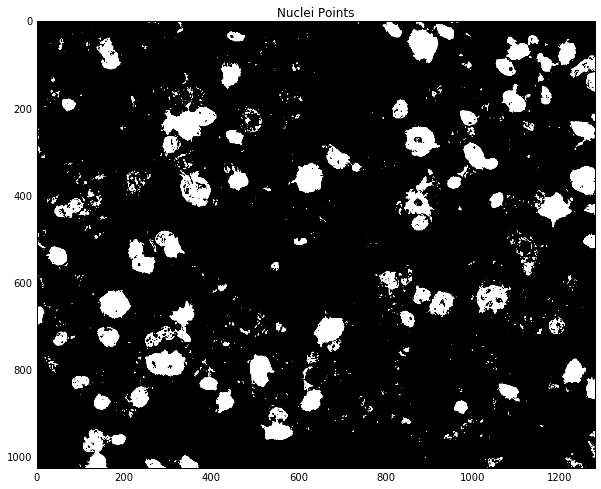

(<matplotlib.image.AxesImage at 0x8e73710>,
 None)

In [8]:
# --------- TESTING HSV THRESHOLDING --------------
b,g,r = cv2.split(img)
rgb_img = cv2.merge([r,g,b])
rg = cv2.merge([r,g,b])
rg = rg.astype(np.float32)

np.seterr(all = 'ignore')
mask = np.empty_like(rg)
arr_max = rg.max(-1)
delta = rg.ptp(-1)
s = delta/arr_max
s[delta==0]=0
idx = (rg[:,:,0] == arr_max)
mask[idx,0] = np.true_divide((rg[idx,1] - rg[idx,2]), delta[idx])
idx = (rg[:,:,1] == arr_max)
mask[idx,0] = 2. + np.true_divide((rg[idx,2] - rg[idx,0]), delta[idx])
idx = (rg[:,:,2] == arr_max)
mask[idx,0] = 4. + np.true_divide((rg[idx,0] - rg[idx,1]), delta[idx])
mask[:,:,0] = ((mask[:,:,0]/6.0)%1.0)*255.0
mask[:,:,0] = np.nan_to_num(mask[:,:,0])
mask[:,:,1] = s * 255.0
mask[:,:,2] = arr_max
mask = mask.astype(np.uint8)

nuclei_points = cv2.inRange(mask, (200, 150, 0), (255,255,195))
plt.imshow(nuclei_points, 'gray'), plt.title("Nuclei Points"), plt.show()

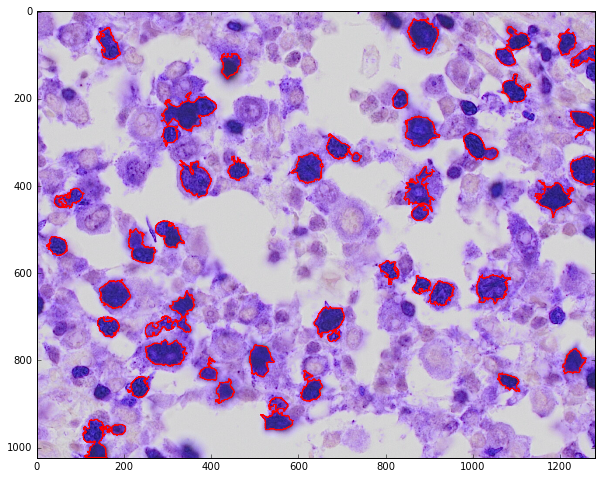

(<matplotlib.image.AxesImage at 0x8aaadd8>, None)

In [9]:
contours, heirarchy = cv2.findContours(nuclei_points, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
cells = []
large_cell = []
for cnt in contours:
    mask = np.zeros(binary_img.shape, np.uint8)
    area = cv2.contourArea(cnt)
    true_area = cv2.contourArea(cnt, True)
    if area >= 1000 and area <= 10000 and true_area < 0:
        cells.append(cnt)


#print(len(total))
gray_img = cv2.imread('Images/mp-16-2852_MCT_AgNOR_1152.tif')
cv2.drawContours(gray_img, cells, -1, (255,0,0),2)
cv2.imshow("Contours", gray_img)
cv2.waitKey(-1)
plt.imshow(gray_img), plt.show()

('Total Area: ', 1379188.0)


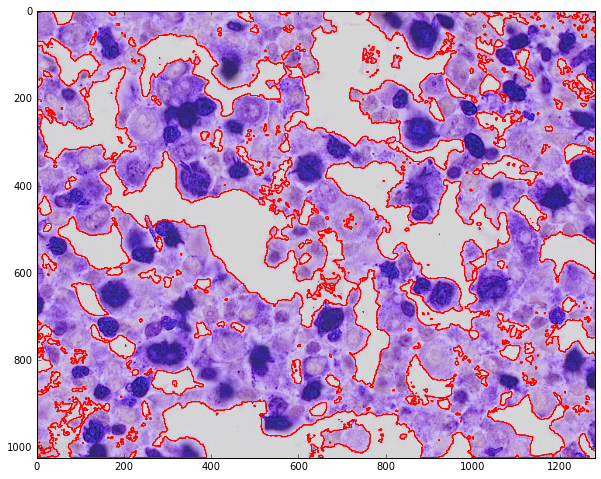

(<matplotlib.image.AxesImage at 0x12c90898>, None)

In [10]:
# ------------- NORMALIZE BACKGROUND -------------------------------
img = cv2.imread("Images/mp-16-2852_MCT_AgNOR_1152.tif")
b,g,r = cv2.split(img)
rgb_img = cv2.merge([r,g,b])
rg = cv2.merge([r,g,b])
rg = rg.astype(np.float32)

np.seterr(all = 'ignore')
mask = np.empty_like(rg)
arr_max = rg.max(-1)
delta = rg.ptp(-1)
s = delta/arr_max
s[delta==0]=0
idx = (rg[:,:,0] == arr_max)
mask[idx,0] = np.true_divide((rg[idx,1] - rg[idx,2]), delta[idx])
idx = (rg[:,:,1] == arr_max)
mask[idx,0] = 2. + np.true_divide((rg[idx,2] - rg[idx,0]), delta[idx])
idx = (rg[:,:,2] == arr_max)
mask[idx,0] = 4. + np.true_divide((rg[idx,0] - rg[idx,1]), delta[idx])
mask[:,:,0] = ((mask[:,:,0]/6.0)%1.0)*255.0
mask[:,:,0] = np.nan_to_num(mask[:,:,0])
mask[:,:,1] = s * 255.0
mask[:,:,2] = arr_max
mask = mask.astype(np.uint8)

nuclei_points = cv2.inRange(mask, (0, 30, 0), (255,255,255))
#nuclei_points = 255 - nuclei_points
#plt.imshow(nuclei_points, 'gray'), plt.title("Nuclei Points"), plt.show()
contours, h = cv2.findContours(nuclei_points, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
total = 0
for c in contours:
    total += cv2.contourArea(c)
print("Total Area: ", total)
cv2.drawContours(img, contours, -1, (255,0,0),2)
plt.imshow(img), plt.show()

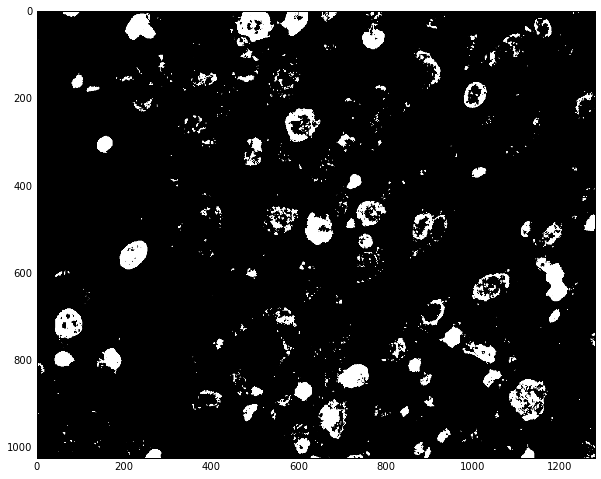

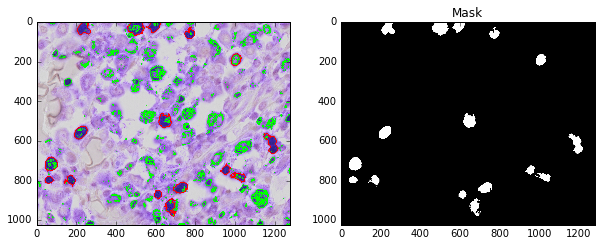

In [11]:
img = cv2.imread("Images/AgNOR_1053.tif")
b,g,r = cv2.split(img)
rg = cv2.merge([r,g,b])
rg = rg.astype(np.float32)

np.seterr(all = 'ignore')
mask = np.empty_like(rg)
arr_max = rg.max(-1)
delta = rg.ptp(-1)
s = delta/arr_max
s[delta==0]=0
idx = (rg[:,:,0] == arr_max)
mask[idx,0] = np.true_divide((rg[idx,1] - rg[idx,2]), delta[idx])
idx = (rg[:,:,1] == arr_max)
mask[idx,0] = 2. + np.true_divide((rg[idx,2] - rg[idx,0]), delta[idx])
idx = (rg[:,:,2] == arr_max)
mask[idx,0] = 4. + np.true_divide((rg[idx,0] - rg[idx,1]), delta[idx])
mask[:,:,0] = ((mask[:,:,0]/6.0)%1.0)*255.0
mask[:,:,0] = np.nan_to_num(mask[:,:,0])
mask[:,:,1] = s * 255.0
mask[:,:,2] = arr_max
mask = mask.astype(np.uint8)

nuclei_points = cv2.inRange(mask, (200, 150, 0), (255,255,195))
plt.imshow(nuclei_points, 'gray'), plt.show()
contours, heirarchy = cv2.findContours(nuclei_points, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
cells = []
cell_area = 0
t1 = np.zeros(nuclei_points.shape, np.uint8)
for cnt in contours:
    area = cv2.contourArea(cnt)
    true_area = cv2.contourArea(cnt, True)
    perimeter = cv2.arcLength(cnt, True)
    equi_diameter = np.sqrt(4*area/np.pi)
    expected_area = np.pi*(equi_diameter/2)*(equi_diameter/2)
    if (perimeter != 0.0):
        circularity_factor = (4*np.pi*area)/(perimeter*perimeter)
        if area >= 1000 and area < 10000 and circularity_factor >= 0.1 and true_area < 0 and expected_area - area < 0.1:
            cells.append(cnt)
            cv2.drawContours(t1, [cnt],0,255,-1)
            cv2.drawContours(img, [cnt], -1, (255,0,0), 3)
            cell_area += area
        else:
            cv2.drawContours(img, [cnt], -1, (0,255,0), 3)

plt.subplot(121)
plt.imshow(img)
plt.subplot(122)
plt.imshow(t1, 'gray'), plt.title('Mask')
plt.show()

In [12]:
print(6)

6


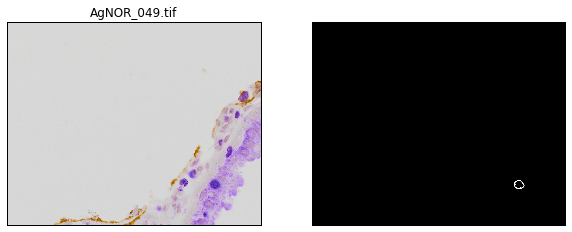

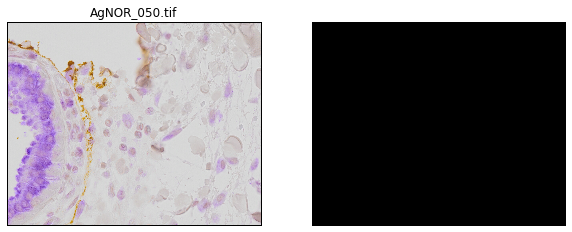

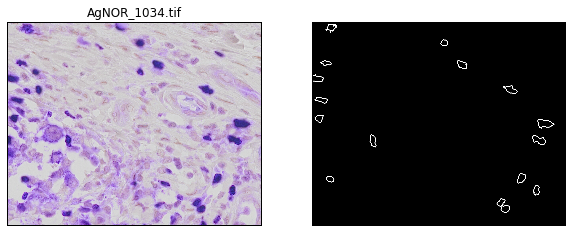

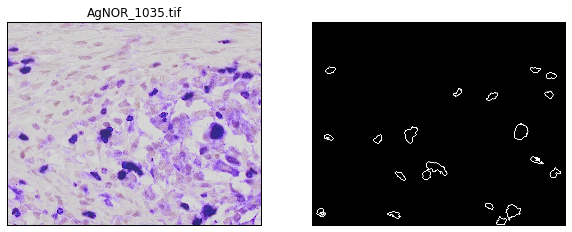

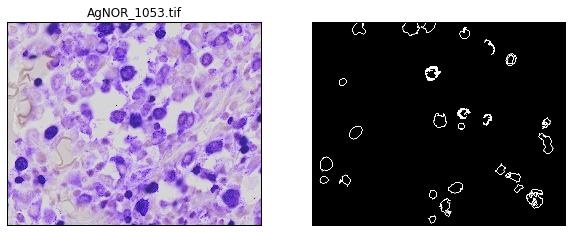

...

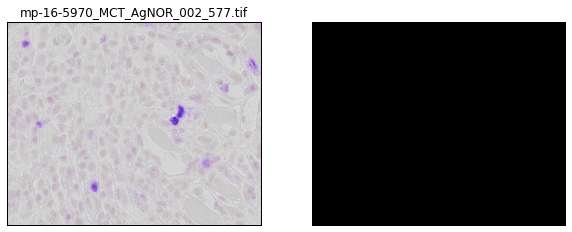

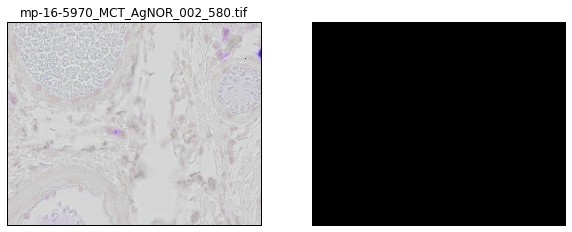

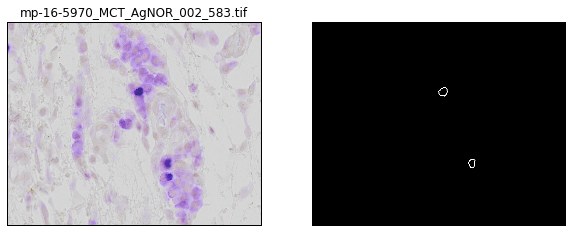

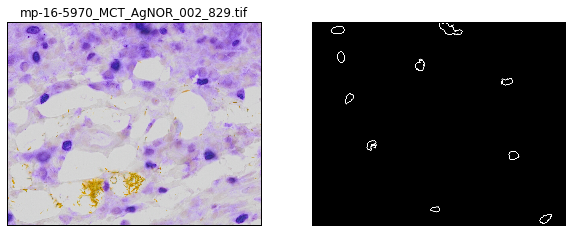

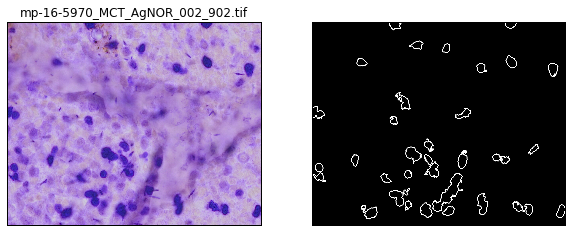

In [13]:
file_path = os.listdir("Images/")
for infile in file_path:
    if "AgNOR" in infile:
        img = cv2.imread('Images/'+infile)
        b,g,r = cv2.split(img)
        rg = cv2.merge([r,g,b])
        rg = rg.astype(np.float32)

        np.seterr(all = 'ignore')
        mask = np.empty_like(rg)
        arr_max = rg.max(-1)
        delta = rg.ptp(-1)
        s = delta/arr_max
        s[delta==0]=0
        idx = (rg[:,:,0] == arr_max)
        mask[idx,0] = np.true_divide((rg[idx,1] - rg[idx,2]), delta[idx])
        idx = (rg[:,:,1] == arr_max)
        mask[idx,0] = 2. + np.true_divide((rg[idx,2] - rg[idx,0]), delta[idx])
        idx = (rg[:,:,2] == arr_max)
        mask[idx,0] = 4. + np.true_divide((rg[idx,0] - rg[idx,1]), delta[idx])
        mask[:,:,0] = ((mask[:,:,0]/6.0)%1.0)*255.0
        mask[:,:,0] = np.nan_to_num(mask[:,:,0])
        mask[:,:,1] = s * 255.0
        mask[:,:,2] = arr_max
        mask = mask.astype(np.uint8)

        nuclei_points = cv2.inRange(mask, (200, 150, 0), (255,255,195))
        contours, h = cv2.findContours(nuclei_points, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)

        new = np.zeros(nuclei_points.shape, np.uint8)
        for c in contours:
            area = cv2.contourArea(c)
            if area >= 750 and area < 10000:
                hull = cv2.convexHull(c)
                hull_area = cv2.contourArea(hull)
                solidity = float(area) / hull_area
                # print('{:.2f}'.format(solidity))
                if solidity > 0.6:
                    cv2.drawContours(new,[c],0,255,3)
                else:
                    cv2.drawContours(new, [c], 0, 255, -1)
                    
        plt.subplot(121), plt.imshow(img), plt.title(infile), plt.xticks([]), plt.yticks([])
        plt.subplot(122), plt.imshow(new, 'gray'), plt.xticks([]), plt.yticks([]), plt.show()

In [14]:
print(4)

4


35
33
35


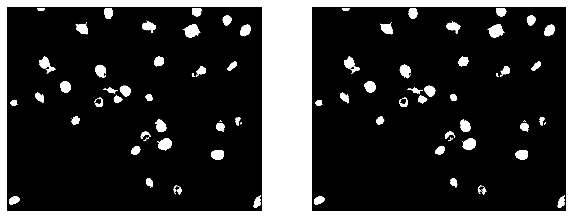

(<matplotlib.axes._subplots.AxesSubplot at 0x3c61630>,
 ([], <a list of 0 Text xticklabel objects>),
 ([], <a list of 0 Text yticklabel objects>),
 None)

In [3]:
# ------------- TESTING COMPARING FILLED CONTOURS VS. UNFILLED --- NO DIFFERENCE IN RESULTS -------------------

img = cv2.imread('Images/mp-16-2852_MCT_AgNOR_1679.tif')
b,g,r = cv2.split(img)
rg = cv2.merge([r,g,b])
rg = rg.astype(np.float32)

np.seterr(all = 'ignore')
mask = np.empty_like(rg)
arr_max = rg.max(-1)
delta = rg.ptp(-1)
s = delta/arr_max
s[delta==0]=0
idx = (rg[:,:,0] == arr_max)
mask[idx,0] = np.true_divide((rg[idx,1] - rg[idx,2]), delta[idx])
idx = (rg[:,:,1] == arr_max)
mask[idx,0] = 2. + np.true_divide((rg[idx,2] - rg[idx,0]), delta[idx])
idx = (rg[:,:,2] == arr_max)
mask[idx,0] = 4. + np.true_divide((rg[idx,0] - rg[idx,1]), delta[idx])
mask[:,:,0] = ((mask[:,:,0]/6.0)%1.0)*255.0
mask[:,:,0] = np.nan_to_num(mask[:,:,0])
mask[:,:,1] = s * 255.0
mask[:,:,2] = arr_max
mask = mask.astype(np.uint8)

nuclei_points = cv2.inRange(mask, (200, 150, 0), (255,255,195))
contours, h = cv2.findContours(nuclei_points, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)

orig_c = []
new = np.zeros(nuclei_points.shape, np.uint8)
t1 = np.zeros(nuclei_points.shape, np.uint8)
for c in contours:
    area = cv2.contourArea(c)
    if area >= 750 and area < 10000:
        hull = cv2.convexHull(c)
        hull_area = cv2.contourArea(hull)
        solidity = float(area) / hull_area
        # print('{:.2f}'.format(solidity))
        if solidity > 0.5:
            cv2.drawContours(new, [c], 0, 255, -1)
            orig_c.append(c)
            
t2 = new.copy()
filled_c, h = cv2.findContours(new, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
print(len(orig_c))
print(len(filled_c))
            
total = []
track = -1
for i in range(len(orig_c)):
    for j in range(len(orig_c[i])):
        for m in range(len(filled_c)):
            x = orig_c[i][j][0][0]
            y = orig_c[i][j][0][1]
            points = (x,y)
            num  = cv2.pointPolygonTest(filled_c[m], points, False )
            if num == 0 or num == 1:
                if cv2.contourArea(filled_c[m]) == cv2.contourArea(orig_c[i]) and track != i:
                    total.append(filled_c[m])
                    track += 1
                break
                
print(len(total))
for c in total:
    cv2.drawContours(t1, [c], 0, 255, -1)

plt.subplot(121), plt.imshow(t1, 'gray'), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(t2, 'gray'), plt.xticks([]), plt.yticks([]), plt.show()

In [7]:
# ------------ TEST 3 POINTS TO FIND CENTER OF CIRCLE TO ELIMINATE LIGHT MIDDLES ------------------

img = cv2.imread('Images/mp-16-2852_MCT_AgNOR_1843.tif')
b,g,r = cv2.split(img)
rg = cv2.merge([r,g,b])
rg = rg.astype(np.float32)

np.seterr(all = 'ignore')
mask = np.empty_like(rg)
arr_max = rg.max(-1)
delta = rg.ptp(-1)
s = delta/arr_max
s[delta==0]=0
idx = (rg[:,:,0] == arr_max)
mask[idx,0] = np.true_divide((rg[idx,1] - rg[idx,2]), delta[idx])
idx = (rg[:,:,1] == arr_max)
mask[idx,0] = 2. + np.true_divide((rg[idx,2] - rg[idx,0]), delta[idx])
idx = (rg[:,:,2] == arr_max)
mask[idx,0] = 4. + np.true_divide((rg[idx,0] - rg[idx,1]), delta[idx])
mask[:,:,0] = ((mask[:,:,0]/6.0)%1.0)*255.0
mask[:,:,0] = np.nan_to_num(mask[:,:,0])
mask[:,:,1] = s * 255.0
mask[:,:,2] = arr_max
mask = mask.astype(np.uint8)

nuclei_points = cv2.inRange(mask, (200, 150, 0), (255,255,195))
contours, h = cv2.findContours(nuclei_points, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)

t1 = np.zeros(nuclei_points.shape, np.uint8)
cnt = []
for c in contours:
    area = cv2.contourArea(c)
    if area >= 750 and area < 10000:
        cnt.append(c)

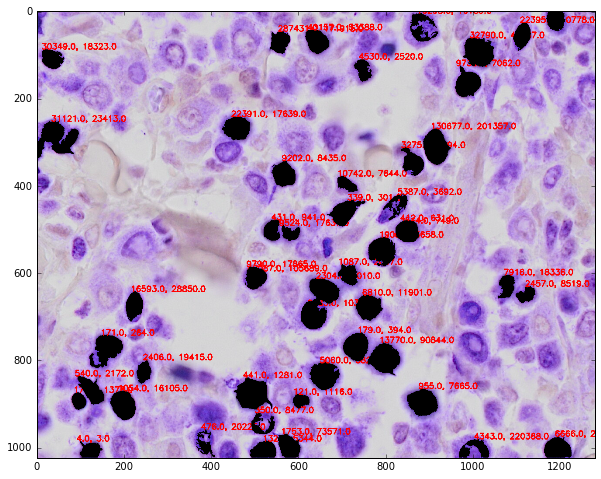

(<matplotlib.image.AxesImage at 0xc0db6d8>, None)

In [8]:
#Given 3 points on circle, finds center of circle (Identifies circles vs. rectangles)

valid_points = []
for c in cnt:
    for point in c:
        x = float(point[0][0])
        y = float(point[0][1])
        if (x <= 5 or y <= 5 or x >= img.shape[1]-5 or y >= img.shape[0]-5) == 0:
            valid_points.append((x,y))

    index = len(valid_points)
    parts = index/ 3

    point = ["","",""]
    mean_x = []
    mean_y = []
    for i in range(parts-1):
        for j in range(3):
            point[j] = valid_points[(parts*j)+i]

        m1 = 0.0
        if point[0][0] != point[1][0]:
            m1 = (point[1][1] - point[0][1])/(point[1][0] - point[0][0])

        m2 = 0.0
        if point[2][0] != point[1][0]:
            m2 = (point[2][1] - point[1][1])/(point[2][0] - point[1][0])

        #print "Point 1: ", point[0]
        #print "Point 2: ", point[1]
        #print "Point 3: ", point[2]
        #print "Slope 1: ", m1
        #print "Slope 2: ", m2
        if m1 != 0.0 and m2-m1 != 0.0:
            center_x = (m1*m2*(point[0][1] - point[2][1]) + m2*(point[0][0] + point[1][0]) - m1*(point[1][0] + point[2][0]))/ (2*(m2 - m1))

            center_y = ((-1.0/m1)*(center_x - ((point[0][0]+point[1][0])/2))) + ((point[0][1] + point[1][1])/2)

            #print center_x, center_y
            mean_x.append(center_x)
            mean_y.append(center_y)
        else:
            #print "Zero"
            pass
        
    cv2.drawContours(img, [c],0, (0,0,0), -1)
    cv2.putText(img, "{:.1f}, {:.1f}".format(int(np.std(mean_x)), int(np.std(mean_y))), (int(x) - 10, int(y)),
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

plt.imshow(img), plt.show()
#print("{:.2f}, {:.2f} -- \tarea: {}".format(np.std(mean_x), np.std(mean_y), cv2.contourArea(c)))